## Research Questions

- What would be the appropriate or comparable price for a future Airbnb listing in the same city in 2020
- Explore what are the strongest predictors for price, what features are irrelevant, and what pertinent new features we can derive from the given predictors

In [3]:
## import required libraries

import pandas as pd
import numpy as np
import pandas_profiling as pp
import altair as alt

from sklearn.model_selection import train_test_split

### Read data

In [4]:
airbnb_ny = pd.read_csv('./data/raw_data.csv')

### Shape of the data

In [5]:
airbnb_ny.shape

(48895, 16)

### Columns

In [6]:
airbnb_ny.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

### Drop columns not required
- id
- name
- host_name
- last_review

In [8]:
airbnb_ny.drop(['id','name','host_name','last_review'], axis=1, inplace=True)

### Split data into train and test

In [9]:
X = airbnb_ny.drop(['price'], axis=1)
y = airbnb_ny.price

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 1) 

In [10]:
print("Number of listings: %d \n" %len(X_train))
print("Neighbourhoods Groups:", list(X_train.neighbourhood_group.unique()), "\n")
print("Number of listings in each neighbourhood group \n")
print(X_train.neighbourhood_group.value_counts())
print("")
print("Number of neighbourhoods:", X_train.neighbourhood.nunique(), "\n")
print("Room types:", list(X_train.room_type.unique()), "\n" )
print("Number of listings for each room type \n")
print(X_train.room_type.value_counts())
print("")
print("Counts of NaN values in each Column \n")
print(X_train.isna().sum())


Number of listings: 39116 

Neighbourhoods Groups: ['Manhattan', 'Staten Island', 'Brooklyn', 'Queens', 'Bronx'] 

Number of listings in each neighbourhood group 

Manhattan        17332
Brooklyn         16089
Queens            4515
Bronx              874
Staten Island      306
Name: neighbourhood_group, dtype: int64

Number of neighbourhoods: 221 

Room types: ['Private room', 'Entire home/apt', 'Shared room'] 

Number of listings for each room type 

Entire home/apt    20377
Private room       17807
Shared room          932
Name: room_type, dtype: int64

Counts of NaN values in each Column 

host_id                              0
neighbourhood_group                  0
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
minimum_nights                       0
number_of_reviews                    0
reviews_per_month                 8002
calculated_host_listings_count       0
availabil

In [11]:
full_train = pd.concat((X_train, y_train), axis= 1)

### Run pandas profiling on training data

In [35]:
pp.ProfileReport(full_train)

In [14]:
from pandas_profiling import ProfileReport
df = pd.DataFrame(
    np.random.rand(100, 5),
    columns=['a', 'b', 'c', 'd', 'e']
)

profile = ProfileReport(df, title='Pandas Profiling Report', style={'full_width':True})


profile

In [27]:
full_data = [X_train, X_test]

### Replace the 'reviews per month' by zero

In [36]:
for data in full_data:
    data.fillna({'reviews_per_month':0}, inplace=True)

In [37]:
X_train.isnull().sum()

host_id                           0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
minimum_nights                    0
number_of_reviews                 0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
dtype: int64

### Feature Relationships

In [47]:
neighbourhood_mean = full_train.groupby('neighbourhood_group').mean().reset_index()

In [48]:
neighbourhood_mean

,neighbourhood_group,host_id,latitude,longitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price
0,Bronx,1.074736e+08,40.848750,-73.884178,4.274600,25.271167,1.493764,2.257437,166.061785,84.551487
1,Brooklyn,5.700137e+07,40.685092,-73.951289,6.020262,23.968363,1.045611,2.300267,100.102182,123.982597
2,Manhattan,6.820059e+07,40.764885,-73.974714,8.425456,20.610374,0.976645,12.790965,110.875029,197.689592
3,Queens,9.672728e+07,40.731263,-73.872927,5.253821,27.525138,1.569996,4.099668,143.634330,99.406866
4,Staten Island,1.013822e+08,40.610412,-74.105378,4.993464,32.153595,1.604477,2.277778,198.415033,121.643791


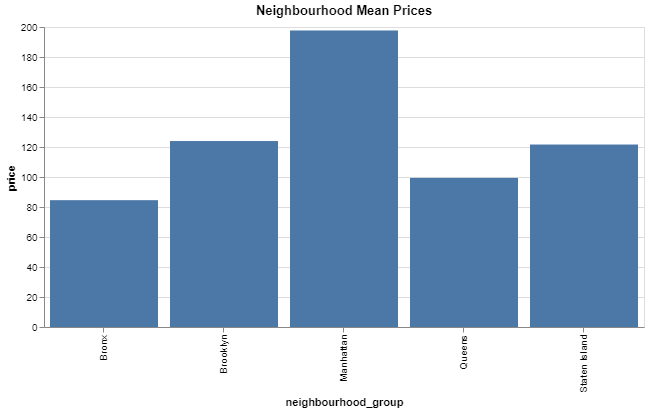

In [52]:
alt.Chart(neighbourhood_mean).mark_bar().encode(
    alt.X('neighbourhood_group:N'),
    alt.Y('price')
).properties(
    width=600,
    height=300,
    title='Neighbourhood Mean Prices'
)

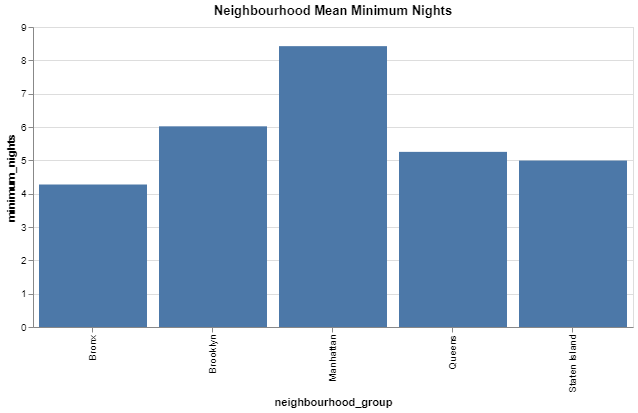

In [54]:
alt.Chart(neighbourhood_mean).mark_bar().encode(
    alt.X('neighbourhood_group:N'),
    alt.Y('minimum_nights')
).properties(
    width=600,
    height=300,
    title='Neighbourhood Mean Minimum Nights'
)

In [56]:
dfg_neighb_room = full_train.groupby("room_type").mean().reset_index()

dfg_neighb_room

,room_type,host_id,latitude,longitude,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price
0,Entire home/apt,6.220299e+07,40.728524,-73.960907,8.392158,22.705649,1.043183,10.699122,111.400550,212.486333
1,Private room,7.281804e+07,40.729195,-73.942980,5.310608,23.660190,1.144125,3.232886,110.401134,89.111754
2,Shared room,1.036962e+08,40.729341,-73.943419,6.761803,16.156652,1.078026,4.611588,161.663090,69.107296


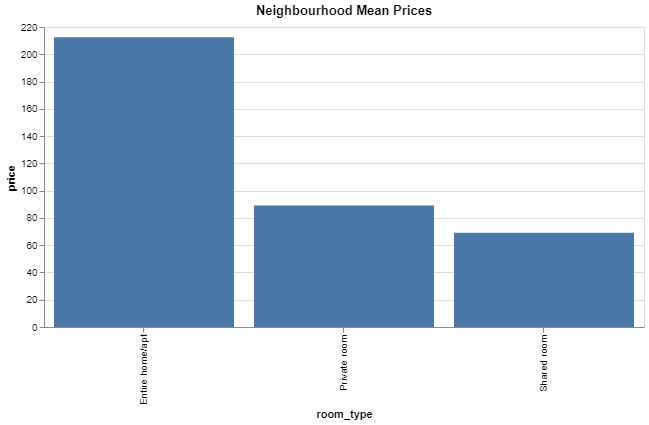

In [57]:
alt.Chart(dfg_neighb_room).mark_bar().encode(
    alt.X('room_type:N'),
    alt.Y('price')
).properties(
    width=600,
    height=300,
    title='Average Prices based on Room Types'
)

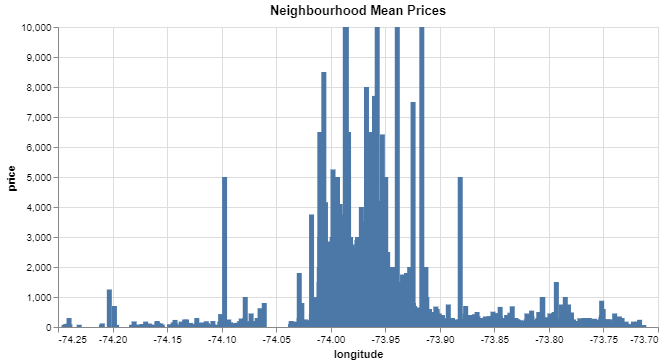

In [60]:
#Price vs Longitude
alt.data_transformers.disable_max_rows()


alt.Chart(full_train).mark_bar().encode(
    alt.X('longitude'),
    alt.Y('price')
).properties(
    width=600,
    height=300,
    title='Prices based on longitude'
)